# Load Packages

In [1]:
%load_ext autoreload
%autoreload 2


# Important libraries
from os.path import join, exists
from os import makedirs
import numpy as np
import pandas as pd
from tqdm import tqdm
import tensorflow as tf
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler
import json
import sys

sys.path.append("../../")

from src.file_manager.save_load_scaler import save_scaler

seed = 2024
data_label = "physionet"

# File paths
fp_notebooks_folder = "../"
fp_project_folder = join(fp_notebooks_folder, "../", "../")
fp_data_folder = join(fp_project_folder, "data")
fp_output_data_folder = join(fp_data_folder, "physionet")
fp_train_data_file = join(fp_data_folder, "filtered_data.csv")
fp_test_data_file = join(fp_data_folder, "filtered_setb.csv")

# Check GPU is available
print(tf.config.list_physical_devices('GPU'))

# function to show df
def display_df(df):
    display(df.head())
    print("Shape:", df.shape)

2025-05-28 16:32:24.546449: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-05-28 16:32:24.557663: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-05-28 16:32:24.561021: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-05-28 16:32:24.569612: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-28 16:32:25.146730: W tensorflow/compiler/tf2

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:3', device_type='GPU')]


I0000 00:00:1748424746.210558   86552 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1748424746.210881   86552 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1748424746.211149   86552 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1748424746.211412   86552 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

# Load Data

In [2]:
train_valid_df = pd.read_csv(fp_train_data_file, index_col=0)
train_valid_df

,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
105,132540,19.183333,80.0,122.0,62.0,82.0,50.0,80.6
106,132540,20.183333,80.0,107.0,55.0,73.0,380.0,80.6
107,132540,21.183333,81.0,121.0,59.0,80.0,170.0,80.6
109,132540,22.183333,80.0,128.0,62.0,83.0,130.0,80.6
110,132540,23.183333,80.0,66.0,32.0,43.0,120.0,80.6
...,...,...,...,...,...,...,...,...
299255,142673,43.600000,86.0,112.0,52.0,75.0,25.0,87.3
299258,142673,44.600000,82.0,108.0,43.0,67.0,25.0,87.3
299259,142673,45.600000,85.0,112.0,50.0,73.0,23.0,87.3
299261,142673,46.600000,86.0,121.0,54.0,80.0,40.0,87.3


In [3]:
test_df = pd.read_csv(fp_test_data_file, index_col=0)
test_df

,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
290,142680,34.283333,89.0,104.0,53.0,68.0,45.0,79.5
294,142680,36.283333,83.0,122.0,64.0,82.0,60.0,79.5
298,142680,39.283333,102.0,115.0,64.0,81.0,400.0,79.5
299,142680,40.283333,100.0,0.0,0.0,246.0,170.0,79.5
302,142680,42.283333,115.0,151.0,92.0,113.0,280.0,79.5
...,...,...,...,...,...,...,...,...
298917,152858,42.216667,71.0,124.0,61.0,83.0,60.0,78.1
298918,152858,43.216667,93.0,128.0,65.0,91.0,100.0,78.1
298920,152858,44.216667,89.0,123.0,69.0,93.0,80.0,78.1
298921,152858,45.216667,74.0,109.0,57.0,76.0,260.0,79.3


In [4]:
feat_cols = ["HR", "SysABP", "DiasABP","MAP", "Urine"]
target_cols = ["HR", "SysABP", "DiasABP","MAP", "Urine"]
print(f"{len(feat_cols)} Input Features: {feat_cols}")
print(f"Output Feature: {target_cols}")

5 Input Features: ['HR', 'SysABP', 'DiasABP', 'MAP', 'Urine']
Output Feature: ['HR', 'SysABP', 'DiasABP', 'MAP', 'Urine']


# Visualizations

In [5]:
train_valid_df[feat_cols].describe()

,HR,SysABP,DiasABP,MAP,Urine
count,46015.000000,46015.000000,46015.000000,46015.000000,46015.000000
mean,87.381962,119.533217,59.383983,79.875454,104.209721
std,16.925870,22.352545,12.376429,15.753337,179.151304
min,14.000000,0.000000,0.000000,0.000000,0.000000
25%,76.000000,104.000000,51.000000,69.000000,35.000000
50%,86.000000,117.000000,58.000000,77.000000,60.000000
75%,98.000000,133.000000,66.000000,88.000000,120.000000
max,200.000000,275.000000,268.000000,300.000000,11000.000000


In [6]:
test_df[feat_cols].describe()

,HR,SysABP,DiasABP,MAP,Urine
count,45416.000000,45416.000000,45416.000000,45416.000000,45416.000000
mean,87.519522,120.067773,59.541703,79.967192,98.863130
std,17.469189,22.829482,12.552292,15.927730,120.343996
min,31.000000,0.000000,0.000000,0.000000,0.000000
25%,75.000000,104.000000,51.000000,69.000000,35.000000
50%,87.000000,117.000000,58.000000,78.000000,60.000000
75%,99.000000,134.000000,66.000000,88.000000,120.000000
max,195.000000,285.000000,272.000000,297.000000,4854.000000


In [7]:
def find_num_duplicates(df, cols):
    new_df = df[cols]
    before = len(new_df)
    new_df = new_df.drop_duplicates()
    after = len(new_df)
    return before-after

find_num_duplicates(train_valid_df, cols=feat_cols)

43

# Preprocessing

## Remove Outliers

In [8]:
def remove_outliers(df):
    df = df.copy()
    df = df[df["DiasABP"]>0]
    df = df[df["SysABP"]>0]
    df = df[df["MAP"]>0]
    df = df[df["Urine"]<=1000]
    return df
train_valid_df = remove_outliers(train_valid_df)
train_valid_df[feat_cols].describe()

,HR,SysABP,DiasABP,MAP,Urine
count,45782.000000,45782.000000,45782.000000,45782.000000,45782.000000
mean,87.370866,119.727164,59.469158,79.752239,97.206507
std,16.911790,21.738244,12.098796,14.972421,104.838776
min,14.000000,11.000000,13.000000,7.000000,0.000000
25%,76.000000,104.000000,51.000000,69.000000,35.000000
50%,86.000000,117.000000,58.000000,77.000000,60.000000
75%,98.000000,133.000000,66.000000,88.000000,120.000000
max,200.000000,275.000000,268.000000,284.000000,1000.000000


In [9]:
test_df = remove_outliers(test_df)
test_df[feat_cols].describe()

,HR,SysABP,DiasABP,MAP,Urine
count,45274.000000,45274.000000,45274.000000,45274.000000,45274.000000
mean,87.516734,120.235477,59.614525,79.862857,96.521931
std,17.463160,22.359495,12.340374,15.351537,102.732080
min,31.000000,10.000000,3.000000,4.000000,0.000000
25%,75.000000,104.000000,51.000000,69.000000,35.000000
50%,87.000000,117.000000,58.000000,78.000000,60.000000
75%,99.000000,134.000000,66.000000,88.000000,120.000000
max,195.000000,285.000000,272.000000,297.000000,1000.000000


## Split Data

In [10]:
def split_data(train_valid_df, test_df, valid_prop=0.1, seed=seed):
    groups = np.array(train_valid_df["record_id"].unique())
    np.random.seed(seed)
    np.random.shuffle(groups)
    num_train_groups = round(0.1*len(groups))
    train_groups, valid_groups = groups[:-num_train_groups], groups[-num_train_groups:]
    train_df = train_valid_df[train_valid_df["record_id"].isin(train_groups)]
    valid_df = train_valid_df[train_valid_df["record_id"].isin(valid_groups)]
    return dict(train_df=train_df, valid_df=valid_df, test_df=test_df)
split_dict = split_data(train_valid_df, test_df)

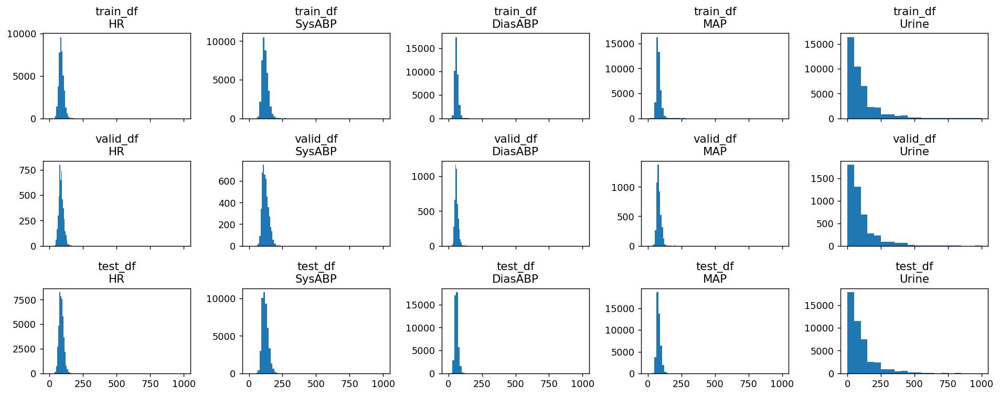

In [11]:
def show_split_stats(split_dict, target_cols):
    fig, axes = plt.subplots(3, len(target_cols), figsize=(len(target_cols)*3, 6), dpi=128, sharex=True)
    for i, (key, val) in enumerate(split_dict.items()):
        for j, target_col in enumerate(target_cols):
            axes[i, j].hist(val[target_col], bins=20)
            axes[i, j].set_title(f"{key}\n{target_col}")
    plt.tight_layout()
    
show_split_stats(split_dict, target_cols)

In [12]:
def display_split(split_dict, cols=None):
    for key, val in split_dict.items():
        print(f"{key}:")
        if cols:
            display_df(val[cols])
        else:
            display_df(val)
        print()
        
display_split(split_dict)

train_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
105,132540,19.183333,80.0,122.0,62.0,82.0,50.0,80.6
106,132540,20.183333,80.0,107.0,55.0,73.0,380.0,80.6
107,132540,21.183333,81.0,121.0,59.0,80.0,170.0,80.6
109,132540,22.183333,80.0,128.0,62.0,83.0,130.0,80.6
110,132540,23.183333,80.0,66.0,32.0,43.0,120.0,80.6


Shape: (41118, 8)

valid_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
469,132551,1.666667,91.0,119.0,52.0,78.0,120.0,48.4
472,132551,5.666667,77.0,104.0,54.0,67.0,130.0,48.4
474,132551,6.666667,87.0,141.0,51.0,82.0,60.0,48.4
477,132551,8.666667,81.0,132.0,44.0,72.0,70.0,48.4
478,132551,9.666667,76.0,129.0,45.0,72.0,40.0,48.4


Shape: (4664, 8)

test_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
290,142680,34.283333,89.0,104.0,53.0,68.0,45.0,79.5
294,142680,36.283333,83.0,122.0,64.0,82.0,60.0,79.5
298,142680,39.283333,102.0,115.0,64.0,81.0,400.0,79.5
302,142680,42.283333,115.0,151.0,92.0,113.0,280.0,79.5
305,142680,44.283333,101.0,101.0,51.0,69.0,200.0,79.5


Shape: (45274, 8)



## Scaling

In [13]:
def scale_data(split_dict, feat_cols):
    split_dict = split_dict.copy()
    scaler = MinMaxScaler()
    split_dict["train_df"].loc[:,feat_cols]= scaler.fit_transform(split_dict["train_df"].loc[:,feat_cols])
    split_dict["valid_df"].loc[:,feat_cols]= scaler.transform(split_dict["valid_df"].loc[:,feat_cols])
    split_dict["test_df"].loc[:,feat_cols]= scaler.transform(split_dict["test_df"].loc[:,feat_cols])
    return split_dict, scaler
split_dict, scaler = scale_data(split_dict, feat_cols)
save_scaler(scaler, join(fp_output_data_folder, "scaler.pickle"))
display_split(split_dict)

train_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
105,132540,19.183333,0.354839,0.420455,0.192157,0.270758,0.05,80.6
106,132540,20.183333,0.354839,0.363636,0.164706,0.238267,0.38,80.6
107,132540,21.183333,0.360215,0.416667,0.180392,0.263538,0.17,80.6
109,132540,22.183333,0.354839,0.443182,0.192157,0.274368,0.13,80.6
110,132540,23.183333,0.354839,0.208333,0.074510,0.129964,0.12,80.6


Shape: (41118, 8)

valid_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
469,132551,1.666667,0.413978,0.409091,0.152941,0.256318,0.12,48.4
472,132551,5.666667,0.338710,0.352273,0.160784,0.216606,0.13,48.4
474,132551,6.666667,0.392473,0.492424,0.149020,0.270758,0.06,48.4
477,132551,8.666667,0.360215,0.458333,0.121569,0.234657,0.07,48.4
478,132551,9.666667,0.333333,0.446970,0.125490,0.234657,0.04,48.4


Shape: (4664, 8)

test_df:


,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
290,142680,34.283333,0.403226,0.352273,0.156863,0.220217,0.045,79.5
294,142680,36.283333,0.370968,0.420455,0.200000,0.270758,0.060,79.5
298,142680,39.283333,0.473118,0.393939,0.200000,0.267148,0.400,79.5
302,142680,42.283333,0.543011,0.530303,0.309804,0.382671,0.280,79.5
305,142680,44.283333,0.467742,0.340909,0.149020,0.223827,0.200,79.5


Shape: (45274, 8)



In [14]:
train_valid_df

,record_id,time,HR,SysABP,DiasABP,MAP,Urine,Weight
105,132540,19.183333,80.0,122.0,62.0,82.0,50.0,80.6
106,132540,20.183333,80.0,107.0,55.0,73.0,380.0,80.6
107,132540,21.183333,81.0,121.0,59.0,80.0,170.0,80.6
109,132540,22.183333,80.0,128.0,62.0,83.0,130.0,80.6
110,132540,23.183333,80.0,66.0,32.0,43.0,120.0,80.6
...,...,...,...,...,...,...,...,...
299255,142673,43.600000,86.0,112.0,52.0,75.0,25.0,87.3
299258,142673,44.600000,82.0,108.0,43.0,67.0,25.0,87.3
299259,142673,45.600000,85.0,112.0,50.0,73.0,23.0,87.3
299261,142673,46.600000,86.0,121.0,54.0,80.0,40.0,87.3


## Flatten

In [15]:
def convert_to_time_series(split_dict, feat_cols, num_history_days=5, num_pred_days=3):
    # Make new columns
    new_feat_cols = [
        f"{feat}_t-{i}"for i in range(num_history_days-1, -1, -1) for feat in feat_cols]
    new_target_cols = [
        f"{target}_t+{i+1}"for i in range(num_pred_days) for target in feat_cols]
    new_feat_cols_with_time = [
        f"{feat}_t-{i}" for i in range(num_history_days-1, -1, -1) for feat in feat_cols+["time"]]
    new_target_cols_with_time = [
        f"{target}_t+{i+1}" for i in range(num_pred_days) for target in feat_cols+["time"]]
    new_cols = new_feat_cols_with_time+new_target_cols_with_time
    
    total_consecutive_days = num_history_days+num_pred_days
    new_split_dict = dict()
    for df_name, df in split_dict.items():
        df_list = []
        pbar = tqdm(df.groupby("record_id"), total=df["record_id"].nunique())
        for record_id, record_df in pbar:
            new_matrix = []
            num_entries_for_record = len(record_df)
            # Skip this record if the number of entries is too little
            if num_entries_for_record < total_consecutive_days:
                continue
            start_i, start_time, consecutive_days = 0, None, 1
            # Loop through possible start times
            while start_i <= (num_entries_for_record-total_consecutive_days):
                start_time = record_df.iloc[start_i]["time"]
                # Check that the next few days (history days + pred) are consecutive 
                for i in range(consecutive_days, total_consecutive_days):
                    cur_i = start_i+i
                    cur_time = record_df.iloc[cur_i]["time"]
                    # If this is not consecutive, 
                    # continue to look for continuous sequences from cur_I
                    if cur_time != start_time + i:
                        start_i = cur_i
                        consecutive_days=1
                        break
                    consecutive_days += 1
                # If all required days are consecutive
                if consecutive_days == total_consecutive_days:
                    new_value_array = record_df.iloc[start_i:start_i+total_consecutive_days][
                        feat_cols+["time"]].values.flatten()
                    new_matrix.append(new_value_array)
                    # Try to start another sequence from the second element
                    start_i=start_i+1
                    consecutive_days=total_consecutive_days-1
            if len(new_matrix) > 0: 
                record_df = pd.DataFrame(new_matrix, columns=new_cols)
                record_df["record_id"] = record_id
                df_list.append(record_df)
        new_split_dict[df_name] = pd.concat(df_list)
    return new_split_dict, new_feat_cols, new_target_cols
new_split_dict, new_feat_cols, new_target_cols = convert_to_time_series(
    split_dict, feat_cols, num_history_days=5, num_pred_days=3)
display_split(new_split_dict)
print(f"New Feature Cols: {new_feat_cols}")
print(f"New Target Cols: {new_target_cols}")

  0%|          | 0/1641 [00:00<?, ?it/s]

  0%|          | 0/182 [00:00<?, ?it/s]

  0%|          | 0/1787 [00:00<?, ?it/s]

train_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,time_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,...,MAP_t+2,Urine_t+2,time_t+2,HR_t+3,SysABP_t+3,DiasABP_t+3,MAP_t+3,Urine_t+3,time_t+3,record_id
0,0.413978,0.518939,0.266667,0.361011,0.185,33.283333,0.440860,0.481061,0.243137,0.335740,...,0.292419,0.05,39.283333,0.301075,0.428030,0.203922,0.296029,0.018,40.283333,132541
0,0.338710,0.621212,0.262745,0.364621,0.190,5.150000,0.317204,0.655303,0.282353,0.389892,...,0.321300,0.08,11.150000,0.301075,0.500000,0.196078,0.292419,0.060,12.150000,132548
1,0.317204,0.655303,0.282353,0.389892,0.050,6.150000,0.338710,0.518939,0.223529,0.306859,...,0.292419,0.06,12.150000,0.349462,0.575758,0.235294,0.342960,0.040,13.150000,132548
2,0.338710,0.518939,0.223529,0.306859,0.040,7.150000,0.349462,0.655303,0.278431,0.389892,...,0.342960,0.04,13.150000,0.397849,0.571970,0.247059,0.602888,0.040,14.150000,132548
3,0.349462,0.655303,0.278431,0.389892,0.080,8.150000,0.327957,0.465909,0.215686,0.292419,...,0.602888,0.04,14.150000,0.333333,0.367424,0.172549,0.234657,0.030,15.150000,132548


Shape: (11608, 49)

valid_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,time_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,...,MAP_t+2,Urine_t+2,time_t+2,HR_t+3,SysABP_t+3,DiasABP_t+3,MAP_t+3,Urine_t+3,time_t+3,record_id
0,0.360215,0.458333,0.121569,0.234657,0.070,8.666667,0.333333,0.446970,0.125490,0.234657,...,0.267148,0.04,14.666667,0.349462,0.556818,0.145098,0.270758,0.06,15.666667,132551
0,0.376344,0.420455,0.188235,0.270758,0.038,18.383333,0.370968,0.420455,0.188235,0.267148,...,0.212996,0.14,24.383333,0.403226,0.352273,0.125490,0.205776,0.14,25.383333,132575
1,0.370968,0.420455,0.188235,0.267148,0.045,19.383333,0.360215,0.318182,0.145098,0.205776,...,0.205776,0.14,25.383333,0.370968,0.378788,0.129412,0.212996,0.21,26.383333,132575
2,0.360215,0.318182,0.145098,0.205776,0.030,20.383333,0.354839,0.299242,0.137255,0.198556,...,0.212996,0.21,26.383333,0.413978,0.446970,0.156863,0.249097,0.10,27.383333,132575
3,0.354839,0.299242,0.137255,0.198556,0.020,21.383333,0.387097,0.356061,0.160784,0.231047,...,0.249097,0.10,27.383333,0.403226,0.378788,0.125490,0.209386,0.12,28.383333,132575


Shape: (1244, 49)

test_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,time_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,...,MAP_t+2,Urine_t+2,time_t+2,HR_t+3,SysABP_t+3,DiasABP_t+3,MAP_t+3,Urine_t+3,time_t+3,record_id
0,0.295699,0.405303,0.192157,0.267148,0.24,33.783333,0.333333,0.443182,0.207843,0.296029,...,0.274368,0.14,39.783333,0.376344,0.424242,0.215686,0.296029,0.15,40.783333,142692
1,0.333333,0.443182,0.207843,0.296029,0.26,34.783333,0.290323,0.405303,0.192157,0.270758,...,0.296029,0.15,40.783333,0.338710,0.390152,0.196078,0.270758,0.15,41.783333,142692
2,0.290323,0.405303,0.192157,0.270758,0.20,35.783333,0.279570,0.375000,0.172549,0.245487,...,0.270758,0.15,41.783333,0.333333,0.397727,0.196078,0.274368,0.14,42.783333,142692
3,0.279570,0.375000,0.172549,0.245487,0.10,36.783333,0.290323,0.386364,0.180392,0.259928,...,0.274368,0.14,42.783333,0.354839,0.416667,0.203922,0.288809,0.20,43.783333,142692
4,0.290323,0.386364,0.180392,0.259928,0.10,37.783333,0.322581,0.371212,0.184314,0.259928,...,0.288809,0.20,43.783333,0.344086,0.428030,0.207843,0.292419,0.10,44.783333,142692


Shape: (12253, 49)

New Feature Cols: ['HR_t-4', 'SysABP_t-4', 'DiasABP_t-4', 'MAP_t-4', 'Urine_t-4', 'HR_t-3', 'SysABP_t-3', 'DiasABP_t-3', 'MAP_t-3', 'Urine_t-3', 'HR_t-2', 'SysABP_t-2', 'DiasABP_t-2', 'MAP_t-2', 'Urine_t-2', 'HR_t-1', 'SysABP_t-1', 'DiasABP_t-1', 'MAP_t-1', 'Urine_t-1', 'HR_t-0', 'SysABP_t-0', 'DiasABP_t-0', 'MAP_t-0', 'Urine_t-0']
New Target Cols: ['HR_t+1', 'SysABP_t+1', 'DiasABP_t+1', 'MAP_t+1', 'Urine_t+1', 'HR_t+2', 'SysABP_t+2', 'DiasABP_t+2', 'MAP_t+2', 'Urine_t+2', 'HR_t+3', 'SysABP_t+3', 'DiasABP_t+3', 'MAP_t+3', 'Urine_t+3']


In [16]:
new_split_dict["train_df"][[col for col in new_split_dict["train_df"].columns if "time" in col]+["record_id"]]

,time_t-4,time_t-3,time_t-2,time_t-1,time_t-0,time_t+1,time_t+2,time_t+3,record_id
0,33.283333,34.283333,35.283333,36.283333,37.283333,38.283333,39.283333,40.283333,132541
0,5.150000,6.150000,7.150000,8.150000,9.150000,10.150000,11.150000,12.150000,132548
1,6.150000,7.150000,8.150000,9.150000,10.150000,11.150000,12.150000,13.150000,132548
2,7.150000,8.150000,9.150000,10.150000,11.150000,12.150000,13.150000,14.150000,132548
3,8.150000,9.150000,10.150000,11.150000,12.150000,13.150000,14.150000,15.150000,132548
...,...,...,...,...,...,...,...,...,...
8,36.600000,37.600000,38.600000,39.600000,40.600000,41.600000,42.600000,43.600000,142673
9,37.600000,38.600000,39.600000,40.600000,41.600000,42.600000,43.600000,44.600000,142673
10,38.600000,39.600000,40.600000,41.600000,42.600000,43.600000,44.600000,45.600000,142673
11,39.600000,40.600000,41.600000,42.600000,43.600000,44.600000,45.600000,46.600000,142673


In [17]:
display_split(new_split_dict, cols=new_feat_cols)

train_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,Urine_t-3,...,HR_t-1,SysABP_t-1,DiasABP_t-1,MAP_t-1,Urine_t-1,HR_t-0,SysABP_t-0,DiasABP_t-0,MAP_t-0,Urine_t-0
0,0.413978,0.518939,0.266667,0.361011,0.185,0.440860,0.481061,0.243137,0.335740,0.10,...,0.370968,0.469697,0.250980,0.335740,0.08,0.284946,0.473485,0.235294,0.324910,0.04
0,0.338710,0.621212,0.262745,0.364621,0.190,0.317204,0.655303,0.282353,0.389892,0.05,...,0.349462,0.655303,0.278431,0.389892,0.08,0.327957,0.465909,0.215686,0.292419,0.11
1,0.317204,0.655303,0.282353,0.389892,0.050,0.338710,0.518939,0.223529,0.306859,0.04,...,0.327957,0.465909,0.215686,0.292419,0.11,0.322581,0.628788,0.254902,0.375451,0.13
2,0.338710,0.518939,0.223529,0.306859,0.040,0.349462,0.655303,0.278431,0.389892,0.08,...,0.322581,0.628788,0.254902,0.375451,0.13,0.338710,0.549242,0.219608,0.321300,0.08
3,0.349462,0.655303,0.278431,0.389892,0.080,0.327957,0.465909,0.215686,0.292419,0.11,...,0.338710,0.549242,0.219608,0.321300,0.08,0.301075,0.500000,0.196078,0.292419,0.06


Shape: (11608, 25)

valid_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,Urine_t-3,...,HR_t-1,SysABP_t-1,DiasABP_t-1,MAP_t-1,Urine_t-1,HR_t-0,SysABP_t-0,DiasABP_t-0,MAP_t-0,Urine_t-0
0,0.360215,0.458333,0.121569,0.234657,0.070,0.333333,0.446970,0.125490,0.234657,0.040,...,0.333333,0.454545,0.117647,0.231047,0.040,0.327957,0.492424,0.121569,0.241877,0.035
0,0.376344,0.420455,0.188235,0.270758,0.038,0.370968,0.420455,0.188235,0.267148,0.045,...,0.354839,0.299242,0.137255,0.198556,0.020,0.387097,0.356061,0.160784,0.231047,0.015
1,0.370968,0.420455,0.188235,0.267148,0.045,0.360215,0.318182,0.145098,0.205776,0.030,...,0.387097,0.356061,0.160784,0.231047,0.015,0.435484,0.329545,0.152941,0.216606,0.120
2,0.360215,0.318182,0.145098,0.205776,0.030,0.354839,0.299242,0.137255,0.198556,0.020,...,0.435484,0.329545,0.152941,0.216606,0.120,0.376344,0.371212,0.141176,0.212996,0.140
3,0.354839,0.299242,0.137255,0.198556,0.020,0.387097,0.356061,0.160784,0.231047,0.015,...,0.376344,0.371212,0.141176,0.212996,0.140,0.403226,0.352273,0.125490,0.205776,0.140


Shape: (1244, 25)

test_df:


,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,Urine_t-3,...,HR_t-1,SysABP_t-1,DiasABP_t-1,MAP_t-1,Urine_t-1,HR_t-0,SysABP_t-0,DiasABP_t-0,MAP_t-0,Urine_t-0
0,0.295699,0.405303,0.192157,0.267148,0.24,0.333333,0.443182,0.207843,0.296029,0.26,...,0.279570,0.375000,0.172549,0.245487,0.10,0.290323,0.386364,0.180392,0.259928,0.10
1,0.333333,0.443182,0.207843,0.296029,0.26,0.290323,0.405303,0.192157,0.270758,0.20,...,0.290323,0.386364,0.180392,0.259928,0.10,0.322581,0.371212,0.184314,0.259928,0.10
2,0.290323,0.405303,0.192157,0.270758,0.20,0.279570,0.375000,0.172549,0.245487,0.10,...,0.322581,0.371212,0.184314,0.259928,0.10,0.317204,0.393939,0.200000,0.274368,0.14
3,0.279570,0.375000,0.172549,0.245487,0.10,0.290323,0.386364,0.180392,0.259928,0.10,...,0.317204,0.393939,0.200000,0.274368,0.14,0.376344,0.424242,0.215686,0.296029,0.15
4,0.290323,0.386364,0.180392,0.259928,0.10,0.322581,0.371212,0.184314,0.259928,0.10,...,0.376344,0.424242,0.215686,0.296029,0.15,0.338710,0.390152,0.196078,0.270758,0.15


Shape: (12253, 25)



# Export

In [18]:
def output_split_dict(split_dict, feat_cols, target_cols, fp_output_data_folder):
    if not exists(fp_output_data_folder):
        makedirs(fp_output_data_folder)
    for split, df in new_split_dict.items():
        fp_df = join(fp_output_data_folder, split+".csv")
        df.to_csv(fp_df)
    info_dict = {
        "feat_cols": feat_cols, 
        "target_cols": {
            "t+1": [col for col in target_cols if "t+1" in col],
            "t+2": [col for col in target_cols if "t+2" in col],
            "t+3": [col for col in target_cols if "t+3" in col],
        }
    }
    fp_json = join(fp_output_data_folder, "data_info.json")
    with open(fp_json, 'w') as f:
        json.dump(info_dict, f)
    print("Split dict saved!")
output_split_dict(new_split_dict, new_feat_cols, new_target_cols, fp_output_data_folder) 

Split dict saved!


# Analyze

## Number of Patients

In [23]:
for split, split_df in new_split_dict.items():
    print(split, split_df["record_id"].nunique())
print("total", sum(split_df["record_id"].nunique() for split, split_df in new_split_dict.items()))

train_df 1147
valid_df 126
test_df 1212
total 2485


# T-SNE

In [48]:
def get_tsne_df(split_dict, feat_cols):
    all_df = []
    for split_name, split_df in split_dict.items():
        split_df = split_df.copy()
        split_df["split"] = split_name
        all_df.append(split_df)
    all_df = pd.concat(all_df)
    tsne = TSNE(n_components=2, random_state=seed)
    all_df[["tsne1", "tsne2"]] = tsne.fit_transform(all_df[feat_cols])
    return all_df
tsne_df = get_tsne_df(new_split_dict, new_feat_cols)
tsne_df

,HR_t-4,SysABP_t-4,DiasABP_t-4,MAP_t-4,Urine_t-4,time_t-4,HR_t-3,SysABP_t-3,DiasABP_t-3,MAP_t-3,...,HR_t+3,SysABP_t+3,DiasABP_t+3,MAP_t+3,Urine_t+3,time_t+3,record_id,split,tsne1,tsne2
0,0.413978,0.518939,0.266667,0.361011,0.185,33.283333,0.440860,0.481061,0.243137,0.335740,...,0.301075,0.428030,0.203922,0.296029,0.018,40.283333,132541,train_df,-24.271542,53.892281
0,0.338710,0.621212,0.262745,0.364621,0.190,5.150000,0.317204,0.655303,0.282353,0.389892,...,0.301075,0.500000,0.196078,0.292419,0.060,12.150000,132548,train_df,-42.787018,59.013077
1,0.317204,0.655303,0.282353,0.389892,0.050,6.150000,0.338710,0.518939,0.223529,0.306859,...,0.349462,0.575758,0.235294,0.342960,0.040,13.150000,132548,train_df,-49.218994,60.570168
2,0.338710,0.518939,0.223529,0.306859,0.040,7.150000,0.349462,0.655303,0.278431,0.389892,...,0.397849,0.571970,0.247059,0.602888,0.040,14.150000,132548,train_df,-48.216221,56.588436
3,0.349462,0.655303,0.278431,0.389892,0.080,8.150000,0.327957,0.465909,0.215686,0.292419,...,0.333333,0.367424,0.172549,0.234657,0.030,15.150000,132548,train_df,-54.822372,56.468712
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,0.430108,0.465909,0.152941,0.234657,0.010,36.183333,0.376344,0.390152,0.141176,0.234657,...,0.344086,0.420455,0.133333,0.238267,0.026,43.183333,152851,test_df,-2.190943,-26.669006
5,0.376344,0.390152,0.141176,0.234657,0.025,37.183333,0.365591,0.401515,0.141176,0.238267,...,0.387097,0.420455,0.133333,0.245487,0.070,44.183333,152851,test_df,-36.907253,-3.771986
6,0.365591,0.401515,0.141176,0.238267,0.033,38.183333,0.376344,0.462121,0.156863,0.267148,...,0.354839,0.397727,0.125490,0.227437,0.024,45.183333,152851,test_df,-36.532700,-4.846635
7,0.376344,0.462121,0.156863,0.267148,0.030,39.183333,0.365591,0.439394,0.152941,0.259928,...,0.360215,0.352273,0.141176,0.227437,0.020,46.183333,152851,test_df,-35.043499,-7.871426


/tmp/ipykernel_5635/684582231.py:25: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


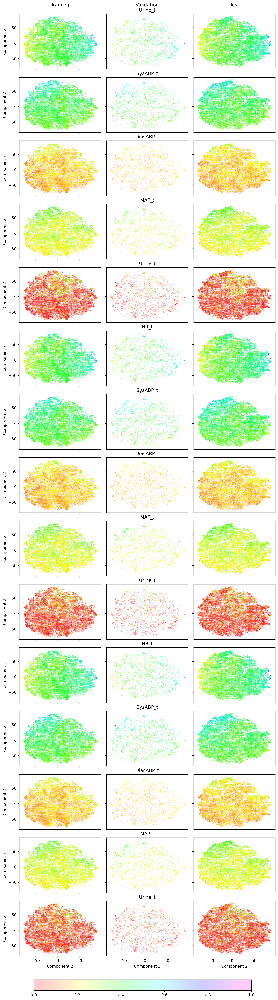

In [51]:
def show_tsne_plot(tsne_df, feat_cols, target_cols):
    from matplotlib.colors import Normalize
    title_map = {"train_df": "Training", "valid_df": "Validation", "test_df": "Test"}
    cmap = plt.get_cmap('gist_rainbow') # https://matplotlib.org/stable/users/explain/colors/colormaps.html
    normalizer = Normalize(0, 1)
    fig, axes = plt.subplots(len(target_cols), 3, figsize=(10, 3*len(target_cols)), dpi=300, sharex=True, sharey=True)
    for i, split_name in enumerate(["train_df", "valid_df", "test_df"]):
        split_df = tsne_df[tsne_df["split"]==split_name]
        # display(class_df)
        cur_x = split_df[["tsne1", "tsne2"]].values
        for j, target_col in enumerate(target_cols):
            cur_y = split_df[target_col]
            im = axes[j, i].scatter(x=cur_x[:, 0], y=cur_x[:, 1], c=cur_y, alpha=0.2, s=2, cmap=cmap,norm=normalizer)
            title = ""
            if i == 1:
                title = target_col[:-2]
            axes[j, i].set_title(title)
            axes[j, 0].set_ylabel("Component 2")
        if i == 1:
            axes[0,i].set_title(title_map[split_name]+"\n"+target_col[:-2])
        else:
            axes[0,i].set_title(title_map[split_name]+"\n")
        axes[-1,i].set_xlabel("Component 2")
    fig.colorbar(im,  orientation="horizontal",  ax=axes.ravel().tolist(), location='bottom', pad=-0.45) 
    plt.tight_layout()
show_tsne_plot(tsne_df, feat_cols, new_target_cols)
# plt.savefig(os.path.join(fp_checkpoint_folder, "consolidated", data_label, f"{data_label}_tsne.jpg"), bbox_inches="tight")